## TexT Data Analysis, Statistical Tests, and Topic Modeling

#### Import Libraries

In [1]:

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objs as go
import chart_studio.plotly as py
import plotly.figure_factory as ff
from plotly.offline import iplot
import cufflinks
cufflinks.go_offline()
cufflinks.set_config_file(world_readable=True, theme='pearl')
from sklearn.feature_extraction.text import CountVectorizer
from wordcloud import WordCloud

import warnings
warnings.filterwarnings('ignore')

### Import Dataset

In [2]:
df = pd.read_csv('Amazon_Smartphones_Reviews_Cleaned_NLTK_Score.csv')

In [3]:
df.head(5)

,Product Name,Brand Name,Price,Rating,Reviews,Review Votes,Sentiments,neg,neu,pos,compound
0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,feel lucky found used phone u used hard phone ...,1.0,1,0.100,0.592,0.308,0.8966
1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,nice phone nice grade pantach revue clean set ...,0.0,1,0.155,0.445,0.400,0.8548
2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,pleased,0.0,1,0.000,0.000,1.000,0.4404
3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,work good go slow sometimes good phone love,0.0,1,0.000,0.333,0.667,0.8750
4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,great phone replace lost phone thing volume bu...,0.0,1,0.103,0.714,0.183,0.4215


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 281249 entries, 0 to 281248
Data columns (total 11 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Product Name  281249 non-null  object 
 1   Brand Name    281249 non-null  object 
 2   Price         281249 non-null  float64
 3   Rating        281249 non-null  int64  
 4   Reviews       280501 non-null  object 
 5   Review Votes  281249 non-null  float64
 6   Sentiments    281249 non-null  int64  
 7   neg           281249 non-null  float64
 8   neu           281249 non-null  float64
 9   pos           281249 non-null  float64
 10  compound      281249 non-null  float64
dtypes: float64(6), int64(2), object(3)
memory usage: 23.6+ MB


In [5]:
# Drop null rows with null values
df    = df.dropna()

## Exploratory Data Analysis

### Summary Statistics

In [6]:
print("\nSummary Statistics:")
summary_stats = df.describe()
print(summary_stats)


Summary Statistics:
               Price         Rating   Review Votes     Sentiments  \
count  280501.000000  280501.000000  280501.000000  280501.000000   
mean      224.674056       3.784061       1.556554       0.729816   
std       288.480683       1.554389       9.710262       0.444056   
min         1.730000       1.000000       0.000000       0.000000   
25%        75.990000       3.000000       0.000000       0.000000   
50%       139.000000       5.000000       0.000000       1.000000   
75%       264.100000       5.000000       1.000000       1.000000   
max      2598.000000       5.000000     645.000000       1.000000   

                 neg            neu            pos       compound  
count  280501.000000  280501.000000  280501.000000  280501.000000  
mean        0.068846       0.555097       0.375854       0.414226  
std         0.129494       0.282860       0.307508       0.472385  
min         0.000000       0.000000       0.000000      -0.995300  
25%         0.000

### Distribution of Sentiments

In [7]:
print("\nDistribution of Sentiments:")
sentiment_counts = df['Sentiments'].value_counts()
print(sentiment_counts)


Distribution of Sentiments:
Sentiments
1    204714
0     75787
Name: count, dtype: int64


### Distribution of Ratings

In [8]:
print("\nDistribution of Ratings:")
rating_counts = df['Rating'].value_counts().sort_index()
print(rating_counts)


Distribution of Ratings:
Rating
1     50137
2     17420
3     22605
4     43054
5    147285
Name: count, dtype: int64


### Distribution of Variations

In [9]:
print("\nDistribution of SmartPhone Brands:")
variation_counts = df['Brand Name'].value_counts()
print(variation_counts)


Distribution of SmartPhone Brands:
Brand Name
samsung                                   54564
blu                                       47997
apple                                     47846
lg                                        18318
blackberry                                14385
                                          ...  
romacostume                                   1
conquest s8 pro 3gb smartphone (black)        1
toshare tech                                  1
h2o                                           1
marozi international ltd                      1
Name: count, Length: 325, dtype: int64


### Data Visualizations

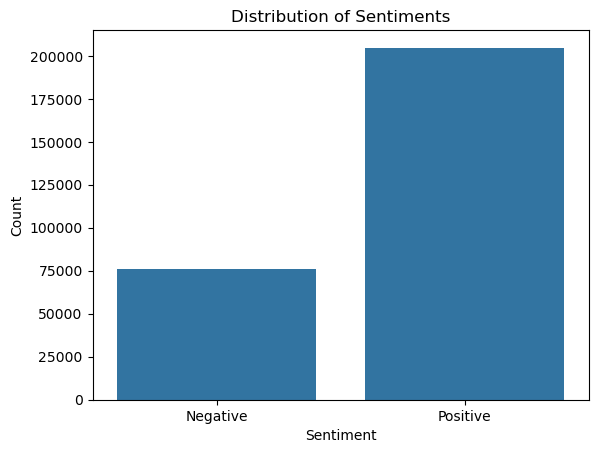

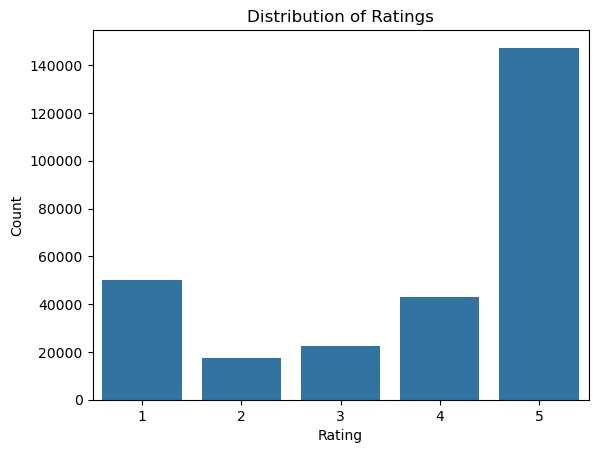

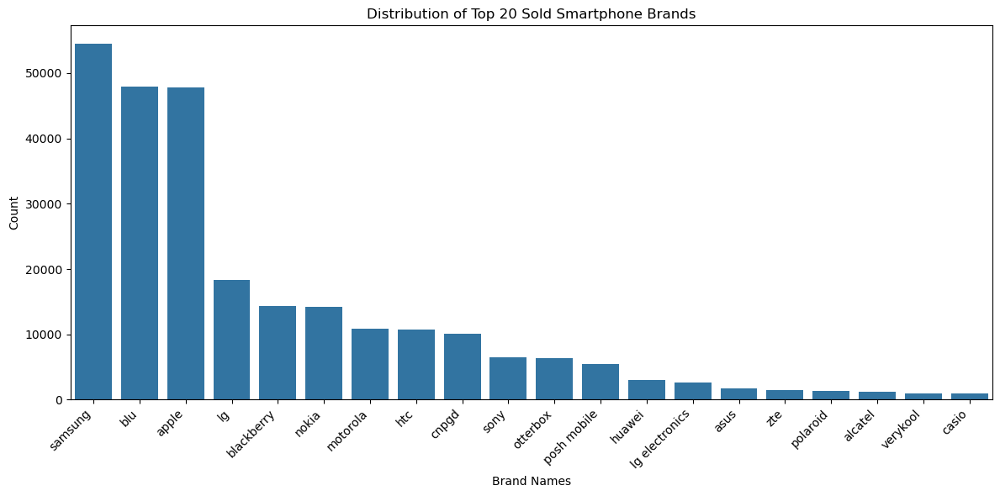

In [10]:
# Distribution of Sentiments (Feedback)
#plt.figure(figsize=(8, 6))
sns.countplot(data=df, x='Sentiments')
plt.title('Distribution of Sentiments')
plt.xlabel('Sentiment')
plt.ylabel('Count')
plt.xticks([0, 1], ['Negative', 'Positive'])
plt.show()

# Distribution of Ratings
#plt.figure(figsize=(8, 6))
sns.countplot(data=df, x='Rating')
plt.title('Distribution of Ratings')
plt.xlabel('Rating')
plt.ylabel('Count')
plt.show()

# Get the top N brands, adjust N as needed
top_n = 20
top_brands = df['Brand Name'].value_counts().nlargest(top_n).index

# Filter the dataframe to include only the top brands
df_top = df[df['Brand Name'].isin(top_brands)]

# Plot the count plot
plt.figure(figsize=(12, 6))
sns.countplot(data=df_top, x='Brand Name', order=top_brands)
plt.title('Distribution of Top {} Sold Smartphone Brands'.format(top_n))
plt.xlabel('Brand Names')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

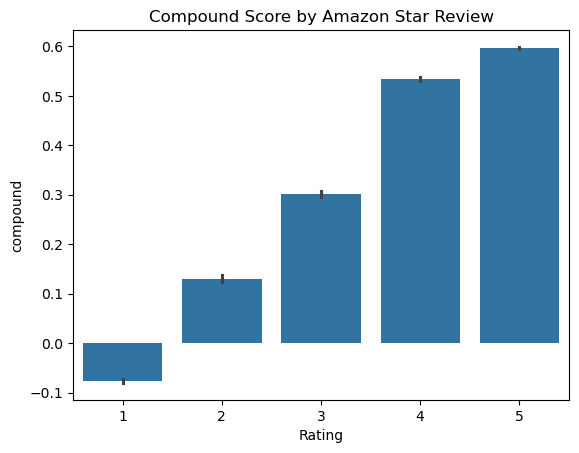

In [11]:
ax = sns.barplot(data=df,   x='Rating', y='compound')
ax.set_title('Compound Score by Amazon Star Review')
plt.show()

Average Compound Scores by Top sold Brands

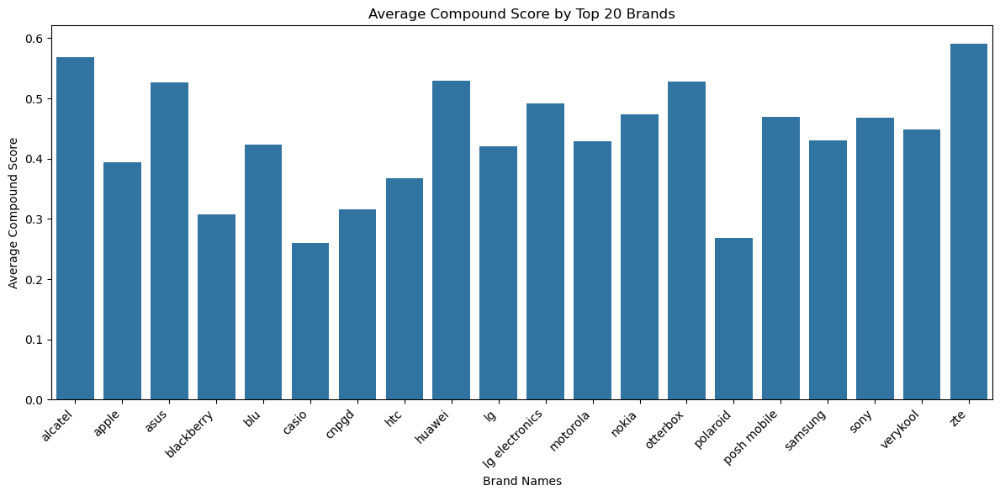

In [12]:


# Get the top 20 brands
top_n = 20
top_brands = df['Brand Name'].value_counts().nlargest(top_n).index

# Filter the dataframe to include only the data for the top 20 brands
df_top = df[df['Brand Name'].isin(top_brands)]

# Calculate the average compound score for each brand
average_scores = df_top.groupby('Brand Name')['compound'].mean().reset_index()

# Plot the average compound scores
plt.figure(figsize=(12, 6))
ax = sns.barplot(data=average_scores, x='Brand Name', y='compound')
ax.set_title('Average Compound Score by Top {} Brands'.format(top_n))
plt.xlabel('Brand Names')
plt.ylabel('Average Compound Score')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


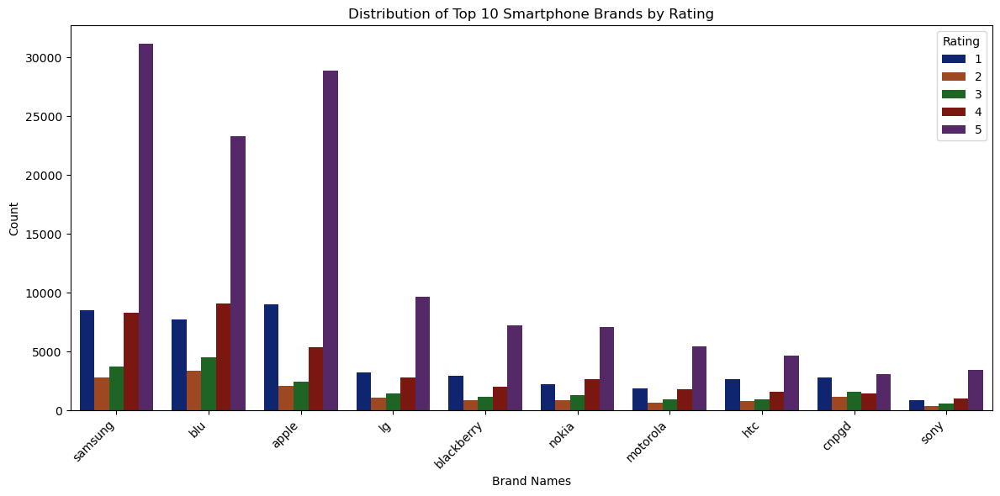

In [13]:

# Get the top N brands, adjust N as needed
top_n = 10
top_brands = df['Brand Name'].value_counts().nlargest(top_n).index

# Filter the dataframe to include only the top brands
df_top = df[df['Brand Name'].isin(top_brands)]

# Define the order of ratings
rating_order = sorted(df['Rating'].unique())

# Plot the count plot with hue
plt.figure(figsize=(12, 6))
sns.countplot(data=df_top, x='Brand Name', hue='Rating',palette='dark', order=top_brands)
plt.title('Distribution of Top {} Smartphone Brands by Rating'.format(top_n))
plt.xlabel('Brand Names')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.legend(title='Rating')
plt.show()


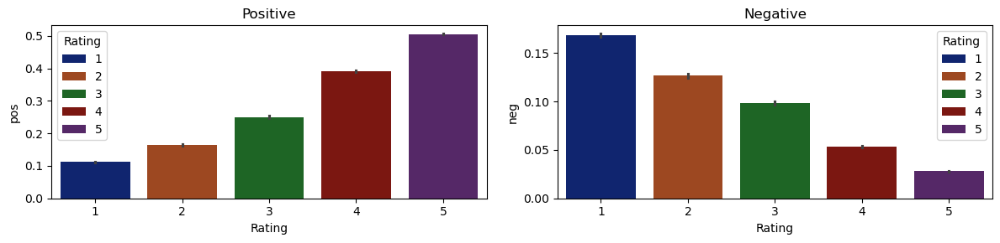

In [14]:
fig, axs = plt.subplots(1, 2, figsize=(12, 3))
sns.barplot(data=df, x='Rating', y='pos', ax=axs[0],hue= 'Rating',palette='dark')
sns.barplot(data=df, x='Rating', y='neg', ax=axs[1],hue= 'Rating',palette='dark')

axs[0].set_title('Positive')
axs[1].set_title('Negative')
plt.tight_layout()
plt.show()


## Text Data Analysis and Statistical Distributions

In [15]:
df['text_len']        = df['Reviews'].astype(str).apply(len)
df['text_word_count'] = df['Reviews'].apply(lambda x: len(str(x).split()))

In [16]:
df.head()

,Product Name,Brand Name,Price,Rating,Reviews,Review Votes,Sentiments,neg,neu,pos,compound,text_len,text_word_count
0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,feel lucky found used phone u used hard phone ...,1.0,1,0.100,0.592,0.308,0.8966,223,37
1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,nice phone nice grade pantach revue clean set ...,0.0,1,0.155,0.445,0.400,0.8548,149,24
2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,pleased,0.0,1,0.000,0.000,1.000,0.4404,7,1
3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,work good go slow sometimes good phone love,0.0,1,0.000,0.333,0.667,0.8750,43,8
4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,great phone replace lost phone thing volume bu...,0.0,1,0.103,0.714,0.183,0.4215,119,18


Creating separate dataframes from rows having positive and negative sentiments

In [17]:
pos = df[df['Sentiments']==1]
neg = df[df['Sentiments']==0]
pos.head()
neg.head()

,Product Name,Brand Name,Price,Rating,Reviews,Review Votes,Sentiments,neg,neu,pos,compound,text_len,text_word_count
5,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,1,already phone problem know stated used dang st...,1.0,0,0.200,0.667,0.133,-0.4215,218,33
6,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,2,charging port loose got soldered needed new ba...,0.0,0,0.113,0.784,0.103,-0.0516,116,18
19,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,3,unfortunately sprint could activate phone due ...,0.0,0,0.238,0.476,0.286,0.0000,112,15
20,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,battery old used barely hold charge otherwise ...,0.0,0,0.000,1.000,0.000,0.0000,57,9
22,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,1,purchased phone december christmas present son...,19.0,0,0.199,0.780,0.021,-0.9397,638,97


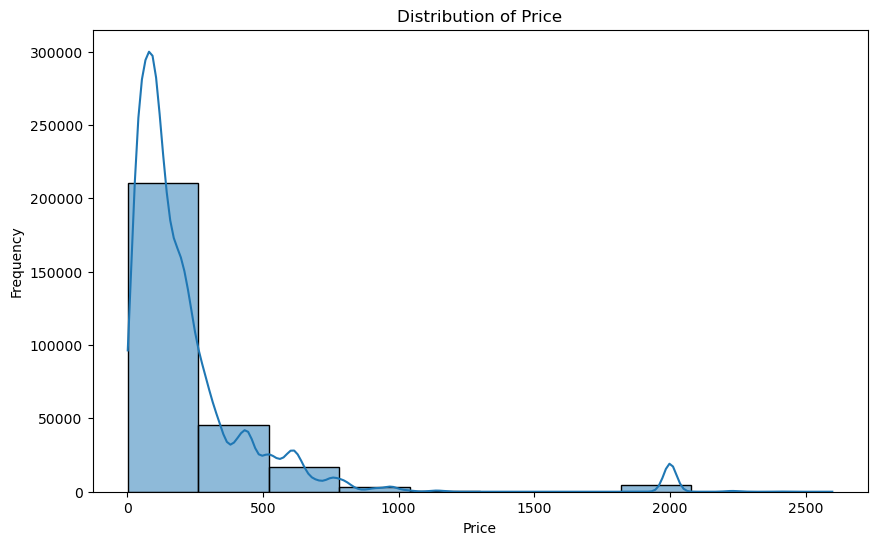

In [18]:
# Plot the distribution of the "Price" column
plt.figure(figsize=(10, 6))
sns.histplot(df['Price'], bins=10, kde=True)
plt.title('Distribution of Price')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

#### Text Length Distribution

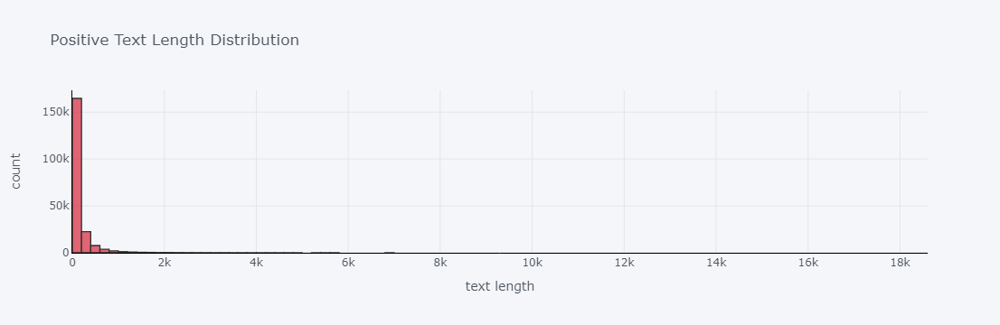

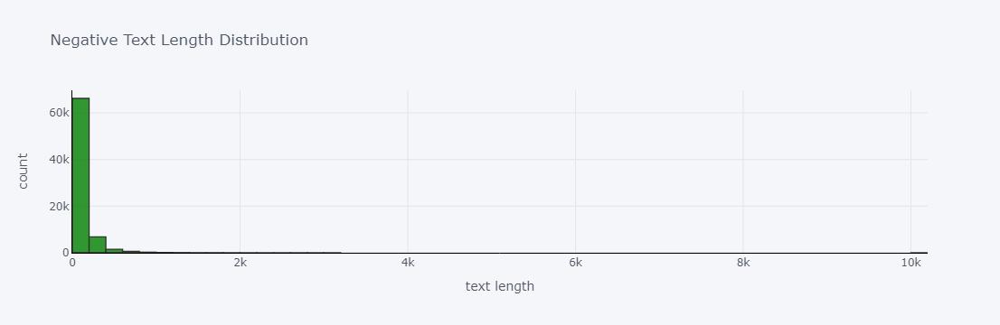

In [19]:

pos['text_len'].iplot(
    kind='hist',
    bins=100,
    xTitle='text length',
    linecolor='black',
    color='red',
    yTitle='count',
    title='Positive Text Length Distribution')

neg['text_len'].iplot(
    kind='hist',
    bins=100,
    xTitle='text length',
    linecolor='black',
    color='green',
    yTitle='count',
    title='Negative Text Length Distribution')



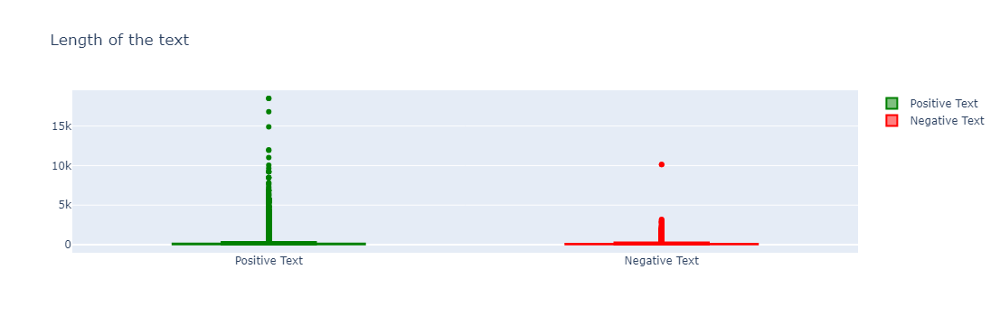

In [20]:
trace0 = go.Box(
    y=pos['text_len'],
    name = 'Positive Text',
    marker = dict(
        color = 'green',
    )
)

trace1 = go.Box(
    y=neg['text_len'],
    name = 'Negative Text',
    marker = dict(
        color = 'red',
    )
)


data = [trace0, trace1]
layout = go.Layout(
    title = "Length of the text"
)

fig = go.Figure(data=data,layout=layout)
iplot(fig, filename = "Length of the text of different polarities")

### Text Word Count

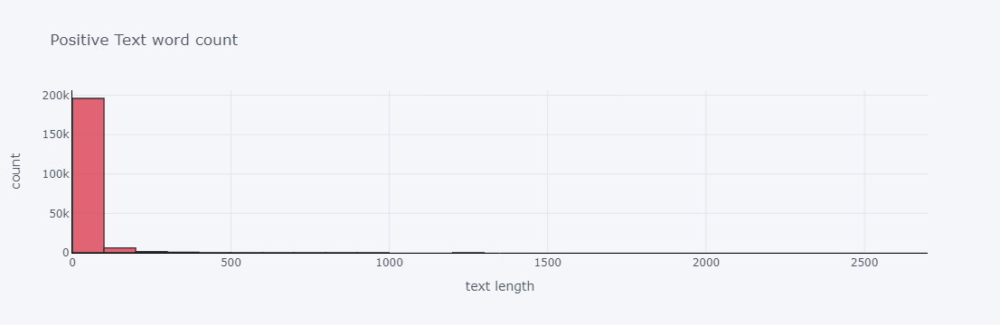

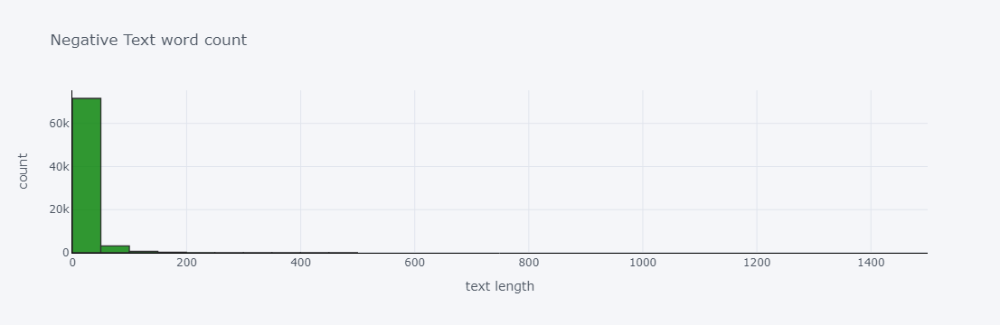

In [21]:
pos['text_word_count'].iplot(
    kind='hist',
    bins=50,
    xTitle='text length',
    linecolor='black',
    color='red',
    yTitle='count',
    title='Positive Text word count')

neg['text_word_count'].iplot(
    kind='hist',
    bins=50,
    xTitle='text length',
    linecolor='black',
    color='green',
    yTitle='count',
    title='Negative Text word count')


 relationship of text lengths with sentiment of the text

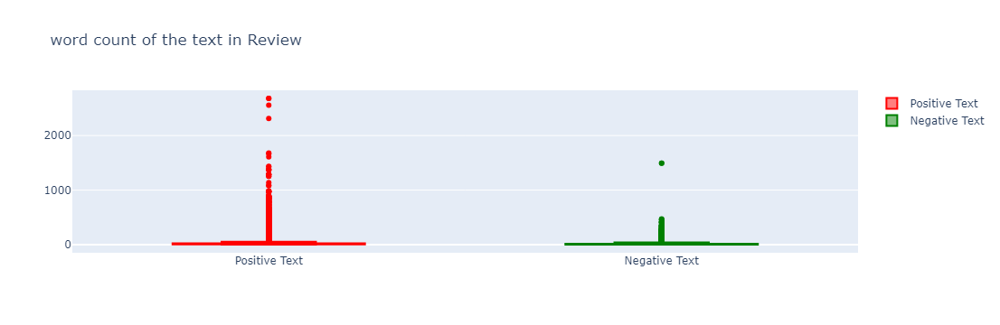

In [22]:
trace0 = go.Box(
    y=pos['text_word_count'],
    name = 'Positive Text',
    marker = dict(
        color = 'red',
    )
)

trace1 = go.Box(
    y=neg['text_word_count'],
    name = 'Negative Text',
    marker = dict(
        color = 'green',
    )
)

data = [trace0, trace1]
layout = go.Layout(
    title = "word count of the text in Review"
)

fig = go.Figure(data=data,layout=layout)
iplot(fig, filename = "word count of the text of different polarities")

#### Most Repeated Words

In [23]:
def get_corpus(text):
    words = []
    for i in text:
        for j in i.split():
            words.append(j.strip())
    return words
corpus = get_corpus(df.Reviews)
corpus[:5]

['feel', 'lucky', 'found', 'used', 'phone']

In [24]:
from collections import Counter
counter = Counter(corpus)
most_common = counter.most_common(10)
most_common = dict(most_common)
most_common

{'phone': 337153,
 'great': 71697,
 'good': 68302,
 'work': 63855,
 'one': 47954,
 'like': 44524,
 'screen': 42218,
 'use': 40095,
 'battery': 39547,
 'get': 37500}

In [25]:
def get_top_text_ngrams(corpus, n, g):
    vec = CountVectorizer(ngram_range=(g, g)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

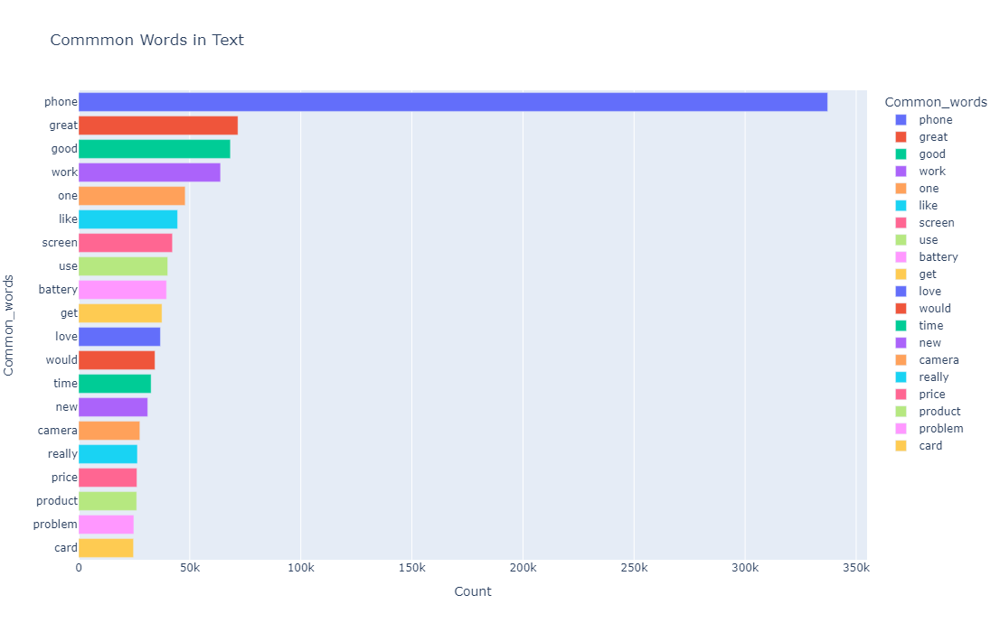

In [26]:
most_common_uni = get_top_text_ngrams(df.Reviews,20,1)
most_common_uni = dict(most_common_uni)
temp = pd.DataFrame(columns = ["Common_words" , 'Count'])
temp["Common_words"] = list(most_common_uni.keys())
temp["Count"] = list(most_common_uni.values())
fig = px.bar(temp, x="Count", y="Common_words", title='Commmon Words in Text', orientation='h', 
             width=700, height=700,color='Common_words')
fig.show()

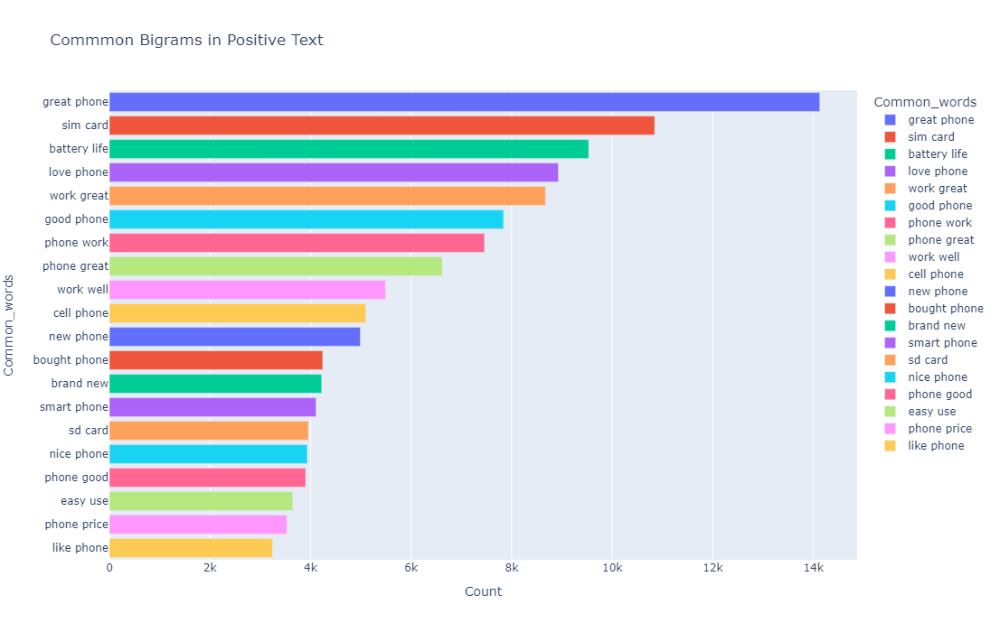

In [27]:
most_common_bi = get_top_text_ngrams(df.loc[df['Sentiments']==1,'Reviews'],20,2)
most_common_bi = dict(most_common_bi)
temp = pd.DataFrame(columns = ["Common_words" , 'Count'])
temp["Common_words"] = list(most_common_bi.keys())
temp["Count"] = list(most_common_bi.values())
fig = px.bar(temp, x="Count", y="Common_words", title='Commmon Bigrams in Positive Text', orientation='h', 
             width=700, height=700,color='Common_words')
fig.show()



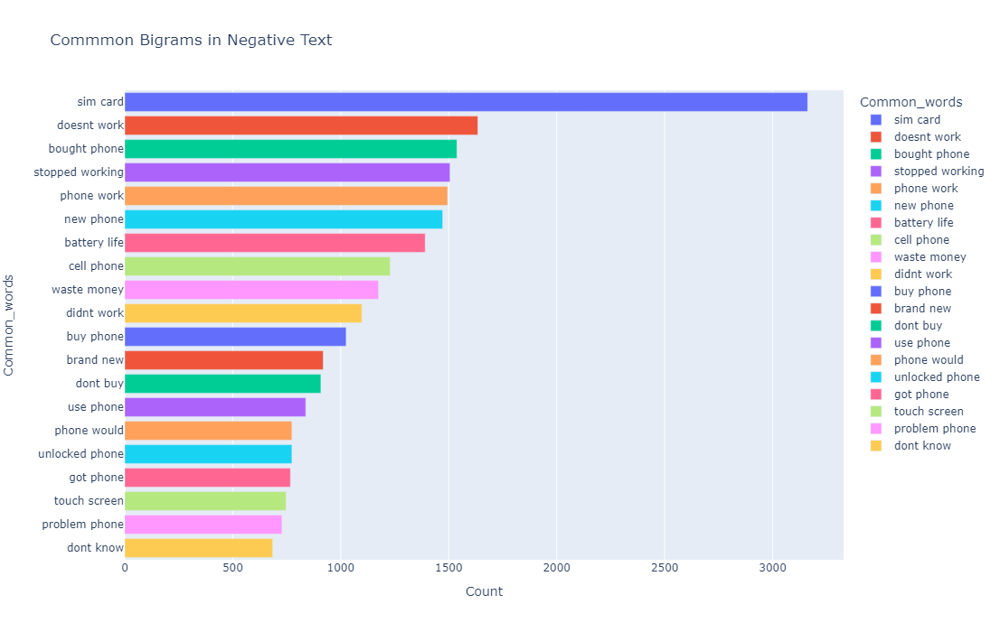

In [28]:
most_common_bi = get_top_text_ngrams(df.loc[df['Sentiments']==0,'Reviews'],20,2)
most_common_bi = dict(most_common_bi)
temp = pd.DataFrame(columns = ["Common_words" , 'Count'])
temp["Common_words"] = list(most_common_bi.keys())
temp["Count"] = list(most_common_bi.values())
fig = px.bar(temp, x="Count", y="Common_words", title='Commmon Bigrams in Negative Text', orientation='h', 
             width=700, height=700,color='Common_words')
fig.show()

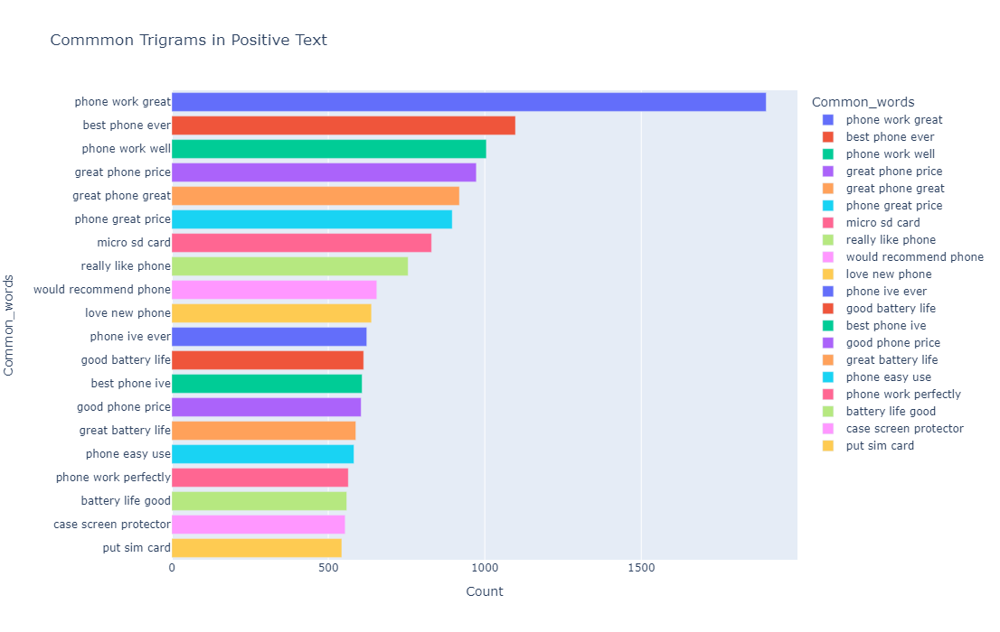

In [29]:
most_common_tri = get_top_text_ngrams(df.loc[df['Sentiments']==1,'Reviews'],20,3)
most_common_tri = dict(most_common_tri)
temp = pd.DataFrame(columns = ["Common_words" , 'Count'])
temp["Common_words"] = list(most_common_tri.keys())
temp["Count"] = list(most_common_tri.values())
fig = px.bar(temp, x="Count", y="Common_words", title='Commmon Trigrams in Positive Text', orientation='h', 
             width=700, height=700,color='Common_words')
fig.show()

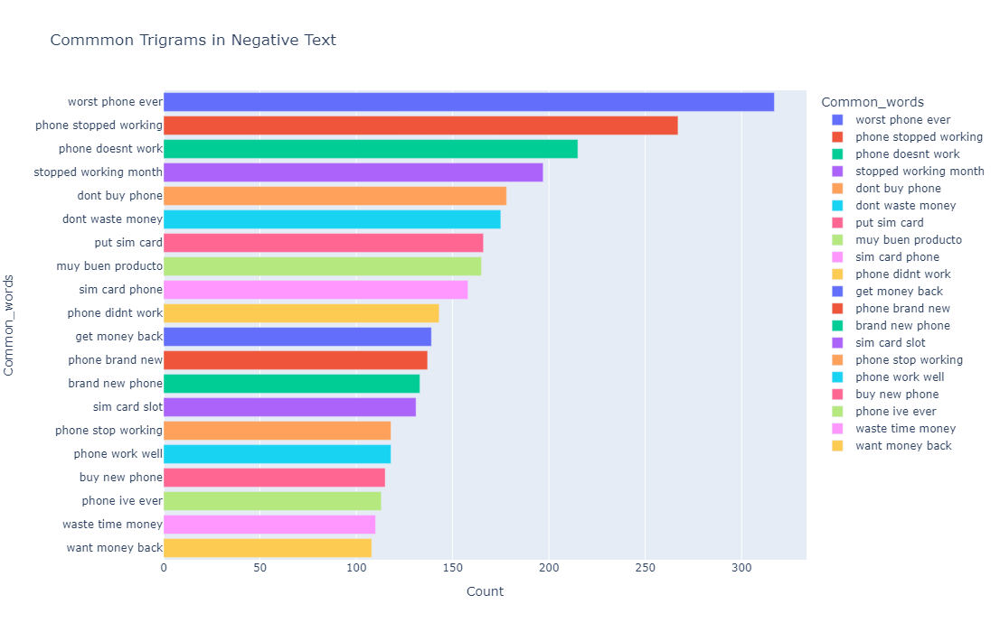

In [30]:
most_common_tri = get_top_text_ngrams(df.loc[df['Sentiments']==0,'Reviews'],20,3)
most_common_tri = dict(most_common_tri)
temp = pd.DataFrame(columns = ["Common_words" , 'Count'])
temp["Common_words"] = list(most_common_tri.keys())
temp["Count"] = list(most_common_tri.values())
fig = px.bar(temp, x="Count", y="Common_words", title='Commmon Trigrams in Negative Text', orientation='h', 
             width=700, height=700,color='Common_words')
fig.show()

### Generate Word Cloud

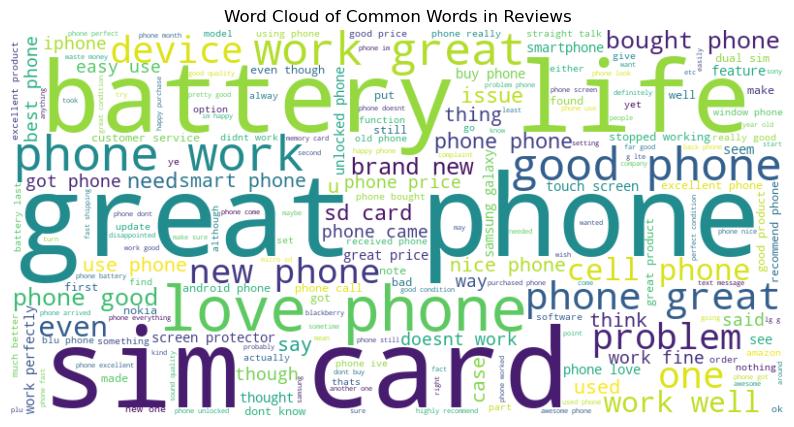

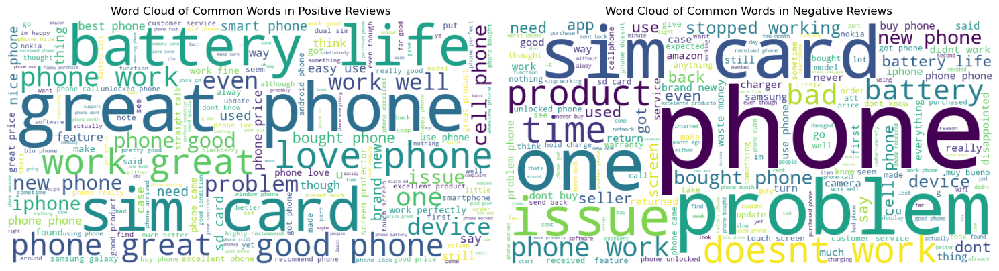

In [31]:
# Combine all reviews into a single string
all_reviews = ' '.join(df['Reviews'])

# Generate a word cloud of the most common words
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_reviews)

# Plot the word cloud
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Common Words in Reviews')
plt.show()

# Separate positive and negative reviews for analysis

positive_reviews = ' '.join(df[df['Sentiments'] == 1]['Reviews'])
negative_reviews = ' '.join(df[df['Sentiments'] == 0]['Reviews'])

# Generate separate word clouds for positive and negative reviews
positive_wordcloud = WordCloud(width=800, height=400, background_color='white').generate(positive_reviews)
negative_wordcloud = WordCloud(width=800, height=400, background_color='white').generate(negative_reviews)

# Plot the word clouds for positive and negative reviews
plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
plt.imshow(positive_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Common Words in Positive Reviews')

plt.subplot(1, 2, 2)
plt.imshow(negative_wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Common Words in Negative Reviews')

plt.tight_layout()
plt.show()

# Statistical Tests 

#### Chi-square test

In [32]:
from scipy.stats import chi2_contingency

# Contingency table between Brand Name and Rating
contingency_table = pd.crosstab(df['Brand Name'], df['Rating'])

# Chi-square test
chi2_stat, p_val, _, _ = chi2_contingency(contingency_table)

alpha = 0.05
print("Chi-square Test of Independence:")
print("Chi-square Statistic:", chi2_stat)
print("p-value:", p_val)


Chi-square Test of Independence:
Chi-square Statistic: 14207.837348772762
p-value: 0.0


In [33]:

alpha = 0.05

if p_val < alpha:
    print("Reject the null hypothesis: There is a significant association between smartphone brand and user ratings.")
else:
    print("Fail to reject the null hypothesis: There is no significant association between smartphone brand and user ratings.")


Reject the null hypothesis: There is a significant association between smartphone brand and user ratings.


#### One-Way ANOVA

In [34]:
from scipy.stats import f_oneway

# Create data for each brand
brand_data = [df[df['Brand Name'] == brand]['Rating'] for brand in top_brands]

# One-Way ANOVA
f_stat, p_val = f_oneway(*brand_data)

print("One-Way ANOVA:")
print("F-statistic:", f_stat)
print("p-value:", p_val)


One-Way ANOVA:
F-statistic: 387.6234170322332
p-value: 0.0


In [35]:
if p_val < alpha:
    print("Reject the null hypothesis: At least one pair of mean user ratings of smartphones differs significantly across smartphone brands.")
else:
    print("Fail to reject the null hypothesis: The mean user ratings of smartphones are the same across all smartphone brands.")


Reject the null hypothesis: At least one pair of mean user ratings of smartphones differs significantly across smartphone brands.


#### Pearson correlation and Spearman correlation

In [36]:
from scipy.stats import pearsonr, spearmanr

# Pearson correlation coefficient
pearson_corr, pearson_p_val = pearsonr(df['Price'], df['Rating'])

# Spearman correlation coefficient
spearman_corr, spearman_p_val = spearmanr(df['Price'], df['Rating'])

In [37]:
print("Correlation Analysis:")
print("Pearson correlation coefficient:", pearson_corr)
print("p-value (Pearson):", pearson_p_val)
print("Spearman correlation coefficient:", spearman_corr)
print("p-value (Spearman):", spearman_p_val)

Correlation Analysis:
Pearson correlation coefficient: 0.07363774491476668
p-value (Pearson): 0.0
Spearman correlation coefficient: 0.1144130011970874
p-value (Spearman): 0.0


In [38]:
if spearman_p_val < alpha or spearman_p_val < alpha:
    print("Reject the null hypothesis: There is a linear (or monotonic) relationship between smartphone price and user ratings.")
else:
    print("Fail to reject the null hypothesis: There is no linear (or monotonic) relationship between smartphone price and user ratings.")

Reject the null hypothesis: There is a linear (or monotonic) relationship between smartphone price and user ratings.


### Topic Modeling NLP

In [39]:
df_topic = pd.read_csv('Amazon_Smartphones_Reviews_Cleaned_NLTK_Score.csv')
# Drop null rows with null values
df_topic    = df_topic.dropna()


#### Reviews

In [40]:
from sklearn.decomposition import NMF
from sklearn.feature_extraction.text import TfidfVectorizer

# TF-IDF Vectorization with bi-grams
tfidf_vectorizer = TfidfVectorizer(preprocessor=lambda x: x.lower(), 
                                   stop_words='english', 
                                   token_pattern=r'\b[a-zA-Z]{3,}\b',
                                   ngram_range=(1, 2))  # Include bi-grams
X_tfidf = tfidf_vectorizer.fit_transform(df_topic['Reviews'])

# Topic Modeling (Non-Negative Matrix Factorization)
nmf_model = NMF(n_components=4, random_state=42)
nmf_model.fit(X_tfidf)

# Displaying topics with bi-grams
feature_names = tfidf_vectorizer.get_feature_names_out()
for topic_idx, topic in enumerate(nmf_model.components_):
    print(f"Topic {topic_idx}:")
    print([feature_names[i] for i in topic.argsort()[-10:]])  # Display more top words for better context


Topic 0:
['work', 'work good', 'phone good', 'good price', 'price', 'product', 'good product', 'phone', 'good phone', 'good']
Topic 1:
['great price', 'product', 'phone great', 'great product', 'price', 'work great', 'work', 'phone', 'great phone', 'great']
Topic 2:
['phone excellent', 'good product', 'recommend', 'condition', 'excellent condition', 'phone', 'excellent phone', 'product', 'excellent product', 'excellent']
Topic 3:
['daughter love', 'love new', 'new', 'perfect', 'love love', 'nice', 'phone love', 'phone', 'love phone', 'love']


Extracting Feature preference using Topic Modeling and 'Product Name'

In [41]:
from sklearn.decomposition import NMF
from sklearn.feature_extraction.text import TfidfVectorizer

# TF-IDF Vectorization with bi-grams
tfidf_vectorizer = TfidfVectorizer(preprocessor=lambda x: x.lower(), 
                                   stop_words='english', 
                                   token_pattern=r'\b[a-zA-Z]{3,}\b',
                                   ngram_range=(1, 2))  # Include bi-grams
X_tfidf = tfidf_vectorizer.fit_transform(df_topic['Product Name'])

# Topic Modeling (Non-Negative Matrix Factorization)
nmf_model = NMF(n_components=4, random_state=42)
nmf_model.fit(X_tfidf)

# Displaying topics with bi-grams
feature_names = tfidf_vectorizer.get_feature_names_out()
for topic_idx, topic in enumerate(nmf_model.components_):
    print(f"Topic {topic_idx}:")
    print([feature_names[i] for i in topic.argsort()[-10:]])  # Display more top words for better context



Topic 0:
['factory unlocked', 'factory', 'cellphone', 'unlocked cellphone', 'version', 'international version', 'international', 'samsung', 'samsung galaxy', 'galaxy']
Topic 1:
['iphone silver', 'iphone white', 'silver', 'gold', 'verizon', 'iphone black', 'iphone unlocked', 'iphone', 'apple', 'apple iphone']
Topic 2:
['black', 'gsm lte', 'cell phone', 'unlocked', 'lte', 'cell', 'camera', 'gsm', 'unlocked gsm', 'phone']
Topic 3:
['unlocked smartphone', 'gsm', 'studio unlocked', 'unlocked', 'gsm unlocked', 'smartphone gsm', 'smartphone', 'studio', 'blu studio', 'blu']
